In [160]:
import pandas as pd
from pymongo import MongoClient
from datetime import datetime
from os import path
from PIL import Image
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
import nltk 
from nltk import tokenize
from nltk.corpus import stopwords
import plotly.graph_objs as go

from plotly.offline import download_plotlyjs, init_notebook_mode, iplot

import plotly.express as px

import matplotlib.pyplot as plt
import matplotlib.pyplot as plt
import networkx as nx
from networkx.algorithms import community  as nxcom

init_notebook_mode(connected=True)

nltk.download('stopwords')

def _connect_mongo(host, port, username, password, db):
    """ A util for making a connection to mongo """

    if username and password:
        mongo_uri = 'mongodb://%s:%s@%s:%s/%s' % (username, password, host, port, db)
        conn = MongoClient(mongo_uri)
    else:
        conn = MongoClient(host, port)


    return conn[db]


def read_mongo(db, collection, query={}, host='localhost', port=27017, username=None, password=None, no_id=True):
    """ Read from Mongo and Store into DataFrame """

    # Connect to MongoDB
    db = _connect_mongo(host=host, port=port, username=username, password=password, db=db)

    # Make a query to the specific DB and Collection
    cursor = db[collection].find(query)

    # Expand the cursor and construct the DataFrame
    df =  pd.DataFrame(list(cursor))

    # Delete the _id
    if no_id:
        del df['_id']

    return df

[nltk_data] Downloading package stopwords to /home/lab/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [254]:
df = read_mongo(db="hearthbeat", collection="wallapop_spain")
def parse_jarr(row, feat="brand"):
    if feat in row["object_data"]["content"].keys():
        return (row["object_data"]["content"][feat])
    else:
        return "unknown"

    
def parse_brand(row):
    if "brand" in row["object_data"]["content"].keys():
        brand = (row["object_data"]["content"]["brand"])
        
        brand = brand.strip()
        brand = brand.split()
        if len(brand)>0:
            brand = brand[0].upper()
            return brand
        else:
            return "unknown"
        
        
    else:
        return "unknown"
    
def filter_brand(row):
    invalid_items = [
        "DUCATI","KTM",
        "VARIAS", "HUSQVARNA",
        "LLANTAS","CARROCERIA",
        "PORTACONTENEDOR",
        "TRIUMPH", "PORTA",
        "ELECTRICA", "HARLEY",
        "APRILIA"
    ]
    
    if row[0] in invalid_items:
        return False
    else:
        return True
    
    
invalid_items = [
    "DUCATI","KTM",
    "VARIAS", "HUSQVARNA",
    "LLANTAS","CARROCERIA",
    "PORTACONTENEDOR",
    "TRIUMPH", "PORTA",
    "ELECTRICA", "HARLEY",
    "APRILIA"
    ]
df = df[df.price != 'unknown']
df["category_id"] = df.apply(lambda row: parse_jarr(row,"category_id"), axis=1)

df = df[df["category_id"]==100]



df["brand"] = df.apply(lambda row: parse_brand(row), axis=1)
df["model"] = df.apply(lambda row: parse_jarr(row,"model"), axis=1)
df["version"] = df.apply(lambda row: parse_jarr(row,"version"), axis=1)
df["km"] = df.apply(lambda row: parse_jarr(row,"km"), axis=1)
df["engine"] = df.apply(lambda row: parse_jarr(row,"engine"), axis=1)
df["gearbox"] = df.apply(lambda row: parse_jarr(row,"gearbox"), axis=1)
df["horsepower"] = df.apply(lambda row: parse_jarr(row,"horsepower"), axis=1)
df["year"] = df.apply(lambda row: parse_jarr(row,"year"), axis=1)
df["distance"] = df.apply(lambda row: parse_jarr(row,"distance"), axis=1)
df['brand'] = df['brand'].str.upper() 
df['model'] = df['model'].str.upper() 
df = df[df.km != 'unknown']
df = df[df.engine != 'unknown']
df = df[df.year != 'unknown']
df = df[df.price > 100]
df = df[df.price < 100000]
df = df[df.year > 1940]
df = df[df.year < 2020]
df = df[df.horsepower != 'unknown']
df = df[df.horsepower < 1000]
df = df[df.horsepower > 40]
df = df[df.gearbox != 'unknown']
df = df[df.version != 'unknown']
df = df[df.model != 'unknown']
df = df[df.brand != 'unknown']
df = df[~df.brand.isin(invalid_items)]


In [255]:
postalcodes = df["postalcode"].unique().tolist()
from geopy.geocoders import Nominatim
geolocator = Nominatim(user_agent="Mozidfffflla")
def get_coords(postalcode, geolocator):
    
    res = geolocator.geocode({"postalcode": postalcode, "country":"Spain"})
    
    addr=(res[0])
    addr = addr.split(',')
    quarter = addr[0]
    district = addr[1]
    coords = res[1]
    
    geo_obj = {
        "lat":coords[0],
        "lon":coords[1],
        "quarter":quarter,
        "district":district
    }
    
    return geo_obj   

postalcode_map={
    
}
for c in postalcodes:
    try:
        if "," in c:
            c = c.split(',')[0]
        postalcode_map[c] = get_coords(c, geolocator)
    except:
        print("unable to find for: "+str(c))

postalcode_map["28668"] = {
    'lat':'40.345131',
    'lon':'-3.835258',
    'quarter':'Alcorcon',
    'district':'Alcorcon'
}
postalcode_map["28910"] = {
    'lat':'40.3167',
    'lon':'-3.75',
    'quarter':'Leganes',
    'district':'Leganes'
}
postalcode_map["28909"] = {
    'lat':'40.304665',
    'lon':'-3.723679',
    'quarter':'Getafe',
    'district':'Getafe'
}
postalcode_map["13342"] = {
    'lat':'38.5688',
    'lon':'-2.92558',
    'quarter':'Puebla del principe',
    'district':'Ciudad real'
}
postalcode_map["28920"] = {
    'lat':'40.345131',
    'lon':'-3.835258',
    'quarter':'Alcorcon',
    'district':'Alcorcon'
}
postalcode_map["28900"] = {
    'lat':'40.304665',
    'lon':'-3.723679',
    'quarter':'Getafe',
    'district':'Getafe'
}
postalcode_map["28669"] = {
    'lat':'40.405',
    'lon':'-3.87835',
    'quarter':'Boadilla del monte',
    'district':'Boadilla dle monte'
}
postalcode_map["28524"] = {
    'lat':'40.3519065',
    'lon':'-3.5357334',
    'quarter':'Rivas-Vaciamadrid',
    'district':'Rivas-Vaciamadrid'
}

unable to find for: 28668
unable to find for: 28910
unable to find for: 28909
unable to find for: 13342
unable to find for: 28920
unable to find for: 28900
unable to find for: 28669
unable to find for: 28669
unable to find for: 28524
unable to find for: unknown


In [256]:

    
def get_coords(row, feat="lat"):
    postalcode = row["postalcode"]
    if "," in postalcode:
        postalcode = postalcode.split(',')[0]
    res = postalcode_map[postalcode]
    return res[feat]


# cars


df = df[df["postalcode"]!='unknown']
df["lat"] = df.apply(lambda row: get_coords(row,"lat"), axis=1)
df["lon"] = df.apply(lambda row: get_coords(row,"lon"), axis=1)
df["quarter"] = df.apply(lambda row: get_coords(row,"quarter"), axis=1)
df["district"] = df.apply(lambda row: get_coords(row,"district"), axis=1)






In [257]:
print("YEAR: ")
print("median:")
print(df["year"].median())
print("mode:")
print(df["year"].mode())
print("mean:")
print(df["year"].mean())
print("min:")
print(df["year"].min())
print("max:")
print(df["year"].max())

YEAR: 
median:
2011.0
mode:
0    2016
dtype: object
mean:
2010.3527423221128
min:
1964
max:
2019


In [258]:
print("KM: ")
print("median:")
print(df["km"].median())
print("mode:")
print(df["km"].mode())
print("mean:")
print(df["km"].mean())
print("min:")
print(df["km"].min())
print("max:")
print(df["km"].max())

KM: 
median:
119100.0
mode:
0    0
dtype: object
mean:
163124.40445409657
min:
0
max:
300000000


In [259]:
print("HORSE POWER: ")
print("median:")
print(df["horsepower"].median())
print("mode:")
print(df["horsepower"].mode())
print("mean:")
print(df["horsepower"].mean())
print("min:")
print(df["horsepower"].min())
print("max:")
print(df["horsepower"].max())

HORSE POWER: 
median:
130.0
mode:
0    150
dtype: object
mean:
143.63968120633487
min:
41.0
max:
900.0


In [260]:
print("PRICE: ")
print("median:")
print(df["price"].median())
print("mode:")
print(df["price"].mode())
print("mean:")
print(df["price"].mean())
print("min:")
print(df["price"].min())
print("max:")
print(df["price"].max())

PRICE: 
median:
9000.0
mode:
0    2500
dtype: object
mean:
11558.53712944626
min:
106.0
max:
99990.0


In [261]:
fig = px.scatter(df, x="horsepower", y="price", trendline="ols")
fig.show()

In [262]:
fig = px.scatter(df, x="price", y="distance", trendline="ols")
fig.show()

In [263]:
fig = px.scatter(df, x="price", y="year", trendline="ols")
fig.show()

In [264]:
print(df["model"].mode())


0    SERIE 3
dtype: object


In [265]:
top_models = df['model'].value_counts()
print(top_models[:10])

SERIE 3    1670
GOLF       1363
IBIZA       936
FOCUS       911
LEON        869
A4          855
MEGANE      825
A3          801
ASTRA       770
SERIE 1     707
Name: model, dtype: int64


In [266]:
top_models = df['brand'].value_counts()
print(top_models[:10])

BMW              5217
VOLKSWAGEN       4031
AUDI             3674
RENAULT          3152
FORD             3037
PEUGEOT          2889
SEAT             2886
OPEL             2677
MERCEDES-BENZ    2633
CITROEN          2044
Name: brand, dtype: int64


In [267]:
top_models = df['gearbox'].value_counts()
print(top_models[:5])

manual       34689
automatic    14120
Name: gearbox, dtype: int64


In [268]:
top_models = df['year'].value_counts()
print(top_models[:5])

2016    4638
2015    3954
2017    3757
2018    2930
2007    2734
Name: year, dtype: int64


In [269]:
top_models = df['km'].value_counts()
print(top_models[:5])

0         627
200000    440
180000    395
220000    392
300000    377
Name: km, dtype: int64


In [270]:
top_models = df['engine'].value_counts()
print(top_models[:5])

Diésel       29248
Gasolina     18089
Eléctrico     1182
Otros          290
Name: engine, dtype: int64


In [271]:
text = " ".join(review for review in df.description)


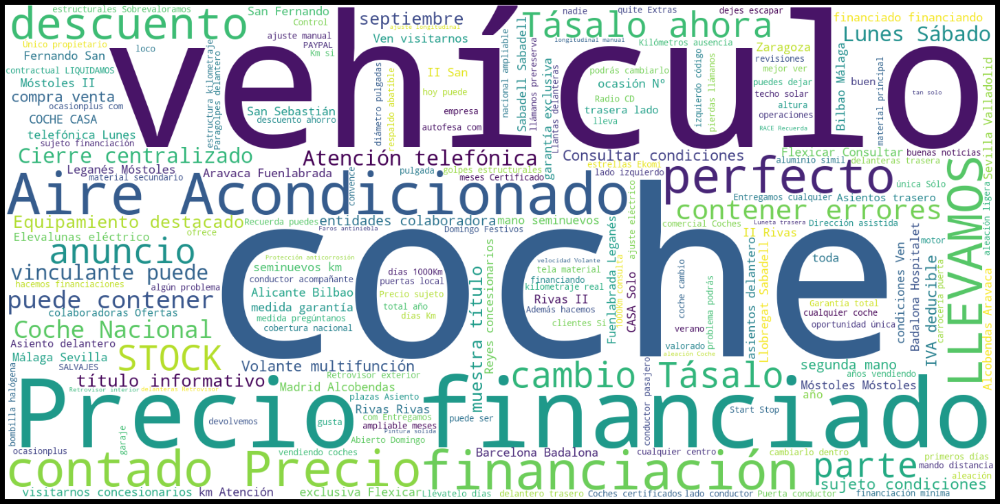

In [272]:
stopwords_fr = set(stopwords.words('french'))
stopwords_en = set(stopwords.words('english'))
stopwords_es = set(stopwords.words('spanish'))

spwords= stopwords_fr | stopwords_en |stopwords_es


wordcloud = WordCloud(width=1600, height=800, stopwords=spwords,background_color="white").generate(text)
# Open a plot of the generated image.

plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
plt.axis("off")
plt.tight_layout(pad=0)

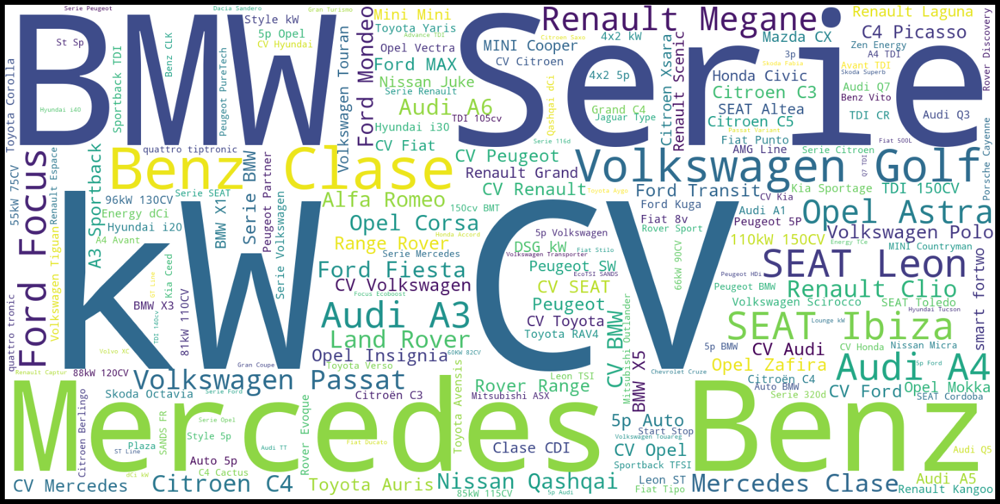

In [273]:
text = " ".join(review for review in df.title)

stopwords_fr = set(stopwords.words('french'))
stopwords_en = set(stopwords.words('english'))
stopwords_es = set(stopwords.words('spanish'))

spwords= stopwords_fr | stopwords_en |stopwords_es


wordcloud = WordCloud(width=1600, height=800, stopwords=spwords,background_color="white").generate(text)
# Open a plot of the generated image.

plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)
plt.axis("off")
plt.tight_layout(pad=0)

In [274]:
brands = df.groupby(['brand','model']).agg({'price':'count'}).reset_index()
brands = brands.sort_values('price', ascending=False)

print(brands)

           brand              model  price
185          BMW            SERIE 3   1670
1443  VOLKSWAGEN               GOLF   1361
1295        SEAT              IBIZA    936
447         FORD              FOCUS    911
1305        SEAT               LEON    869
...          ...                ...    ...
1033        OPEL              AGILA      1
1030        OPEL            1.9CDTI      1
300      CITROEN  GRAND C 4 PICASSO      1
297      CITROEN           E-MEHARI      1
957         MINI          MINI ONE       1

[1547 rows x 3 columns]


In [275]:
fig = px.treemap(brands, path=['brand'], values='price')
fig.show()

fig = px.treemap(brands, path=['brand','model'], values='price')
fig.show()

In [276]:
mapbox_at= "pk.eyJ1IjoiY3VyYXNhbzk5IiwiYSI6ImNrZTl2eTJpeDJhaDEzN243YXdjY24zN20ifQ.cRm0go3r-tdZdTU-GBQitw"

fig = px.density_mapbox(df, lat="lat", lon="lon", z="price",radius=12,
                        center=dict(lat=40.25, lon=-3.70), zoom=6)


fig.update_layout(mapbox_style="basic", mapbox_accesstoken=mapbox_at)
fig.show()




fig = px.scatter_mapbox(df, lat="lat", lon="lon", color="district",
                  color_continuous_scale=px.colors.cyclical.IceFire, size_max=15, center=dict(lat=40.25, lon=-3.70), zoom=6)
fig.update_layout(mapbox_style="dark", mapbox_accesstoken=mapbox_at)
fig.show()

In [277]:
import json


with open('MADRID.geojson') as json_file:
    counties = json.load(json_file)


In [278]:
zips = df.groupby(['postalcode']).agg(totalprice=('price','sum'), offercount=('price','count')).reset_index()

zips=zips.rename(columns = {'postalcode':'COD_POSTAL'}, inplace = False)
print(zips.head())

  COD_POSTAL    totalprice  offercount
0      07014  1.755000e+04           3
1      08719  9.000000e+03           3
2      13342  1.150000e+04           2
3      26002  5.100000e+04           3
4      28001  3.058694e+07        3579


In [279]:
import pandas as pd
import numpy as np
import geopandas as gpd
import matplotlib.pyplot as plt

In [280]:
map_df = gpd.read_file("MADRID.geojson")


In [281]:
map_df.head()


,ID_CP,COD_POSTAL,ALTA_DB,CODIGO_INE,geometry
0,2.807900e+11,28008,2015-07-09,28079,"POLYGON ((-3.71876 40.43541, -3.71885 40.43479..."
1,2.808200e+11,28410,2015-07-09,28082,"POLYGON ((-3.80095 40.71125, -3.80207 40.71215..."
2,2.800300e+11,28749,2015-07-09,28003,"POLYGON ((-3.80866 40.88823, -3.80929 40.88729..."
3,2.817300e+11,28598,2015-07-09,28173,"POLYGON ((-3.25773 40.05275, -3.25771 40.05253..."
4,2.817900e+11,28512,2015-07-09,28179,"POLYGON ((-3.28819 40.33271, -3.28820 40.33271..."


  COD_POSTAL    totalprice  offercount
0      07014  1.755000e+04           3
1      08719  9.000000e+03           3
2      13342  1.150000e+04           2
3      26002  5.100000e+04           3
4      28001  3.058694e+07        3579


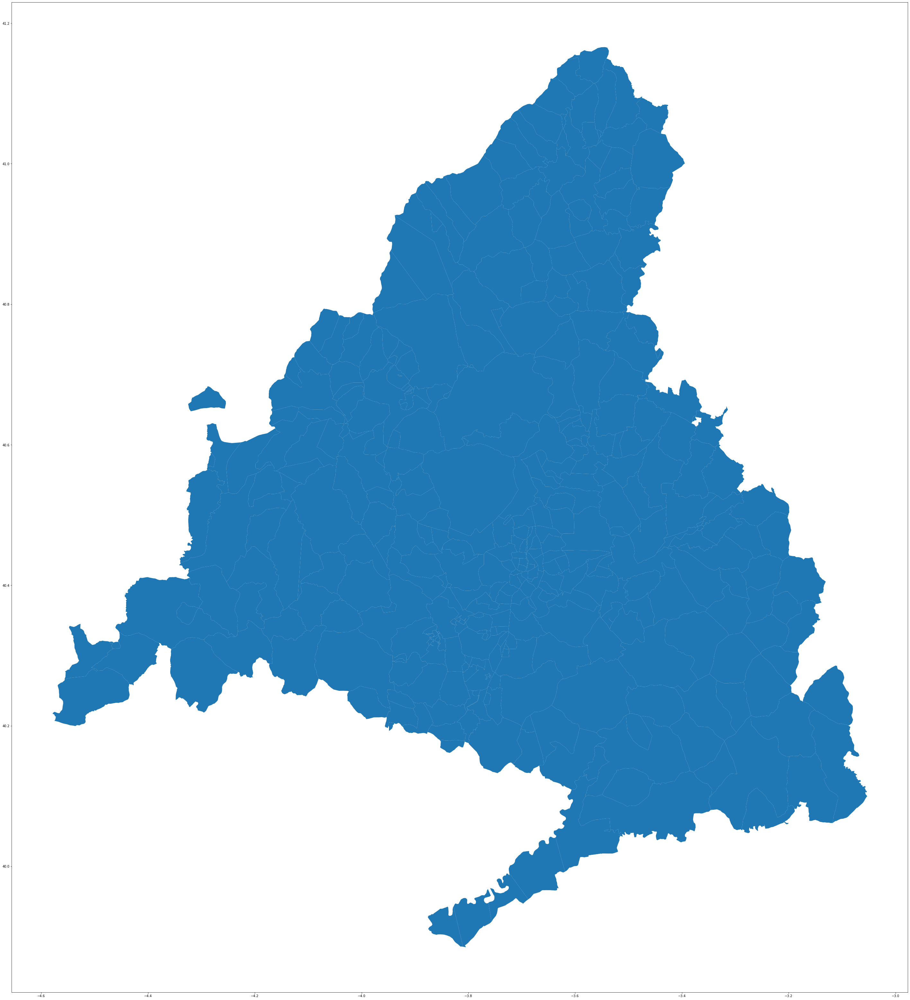

In [282]:
plt.rcParams['figure.figsize'] = [50, 70] #height, width
map_df.plot()
print(zips.head())

In [283]:
merged = map_df.merge(zips, how='left', left_on="COD_POSTAL", right_on="COD_POSTAL")
 

In [284]:
merged = (merged.dropna())


print(merged[:5])

          ID_CP COD_POSTAL     ALTA_DB  CODIGO_INE  \
0  2.807900e+11      28008  2015-07-09       28079   
6  2.809200e+11      28932  2015-07-09       28092   
7  2.807900e+11      28053  2015-07-09       28079   
8  2.807900e+11      28041  2015-07-09       28079   
9  2.809200e+11      28933  2015-07-09       28092   

                                            geometry    totalprice  offercount  
0  POLYGON ((-3.71876 40.43541, -3.71885 40.43479...  1.066449e+06       153.0  
6  POLYGON ((-3.86328 40.32835, -3.86333 40.32856...  1.037990e+05        12.0  
7  POLYGON ((-3.66055 40.39356, -3.66069 40.39331...  1.772470e+06       359.0  
8  POLYGON ((-3.68934 40.38186, -3.68872 40.38143...  4.038715e+06       745.0  
9  POLYGON ((-3.86314 40.32706, -3.86344 40.32701...  1.350000e+04         1.0  


<AxesSubplot:title={'center':'Total amount of money in offers per quarter (postal code)'}>

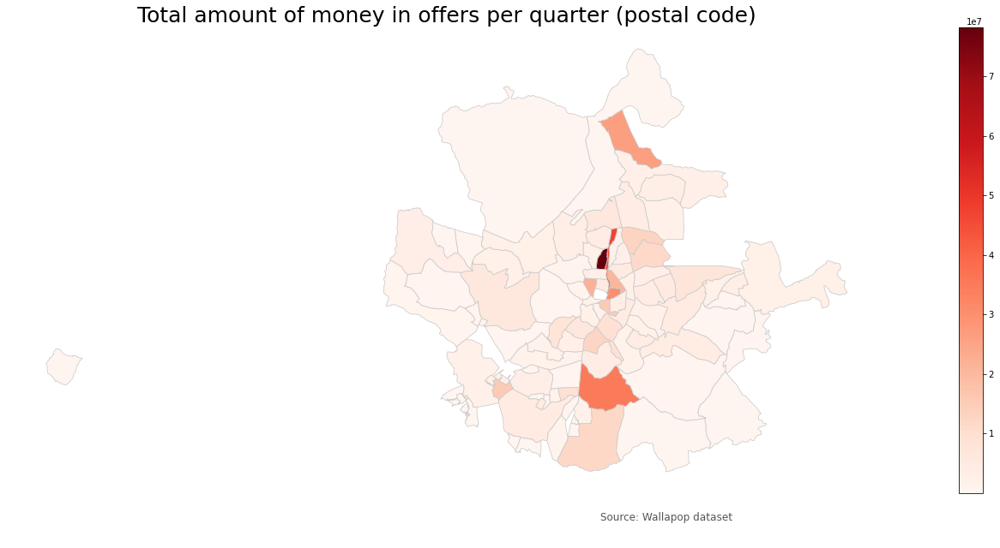

In [285]:
# set the value column that will be visualised
variable = 'totalprice'
# set the range for the choropleth values
vmin = merged["totalprice"].min()
vmax = merged["totalprice"].max()
# create figure and axes for Matplotlib
fig, ax = plt.subplots(1, figsize=(30, 10))
# remove the axis
ax.axis('off')
# add a title and annotation
ax.set_title('Total amount of money in offers per quarter (postal code)', fontdict={'fontsize': '25', 'fontweight' : '3'})
ax.annotate('Source: Wallapop dataset', xy=(0.6, .05), xycoords='figure fraction', fontsize=12, color='#555555')
# Create colorbar legend
sm = plt.cm.ScalarMappable(cmap='Reds', norm=plt.Normalize(vmin=vmin, vmax=vmax))
# empty array for the data range
sm.set_array([]) # or alternatively sm._A = []. Not sure why this step is necessary, but many recommends it
# add the colorbar to the figure
fig.colorbar(sm)
# create map
merged.plot(column=variable, cmap='Reds', linewidth=0.8, ax=ax, edgecolor='0.8')

<AxesSubplot:title={'center':'Number of offers per quarter(postal code)'}>

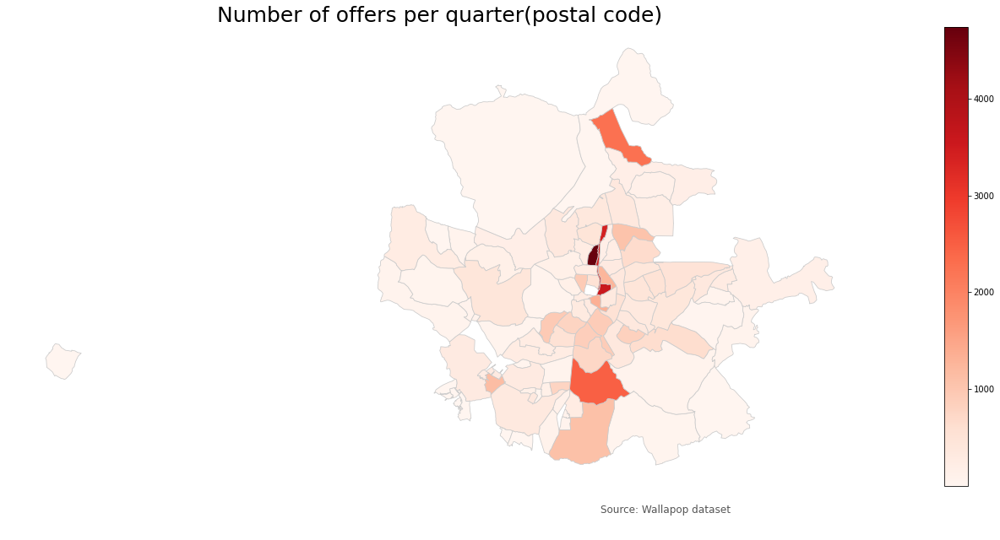

In [286]:
# set the value column that will be visualised
variable = 'offercount'
# set the range for the choropleth values
vmin = merged["offercount"].min()
vmax = merged["offercount"].max()
# create figure and axes for Matplotlib
fig, ax = plt.subplots(1, figsize=(30, 10))
# remove the axis
ax.axis('off')
# add a title and annotation
ax.set_title('Number of offers per quarter(postal code)', fontdict={'fontsize': '25', 'fontweight' : '3'})
ax.annotate('Source: Wallapop dataset', xy=(0.6, .05), xycoords='figure fraction', fontsize=12, color='#555555')
# Create colorbar legend
sm = plt.cm.ScalarMappable(cmap='Reds', norm=plt.Normalize(vmin=vmin, vmax=vmax))
# empty array for the data range
sm.set_array([]) # or alternatively sm._A = []. Not sure why this step is necessary, but many recommends it
# add the colorbar to the figure
fig.colorbar(sm)
# create map
merged.plot(column=variable, cmap='Reds', linewidth=0.8, ax=ax, edgecolor='0.8')

In [287]:
fig = px.scatter(zips, x="offercount", y="totalprice", trendline="ols")
fig.show()


zips.corr()



,totalprice,offercount
totalprice,1.000000,0.959609
offercount,0.959609,1.000000


In [290]:
print(df["brand"].unique())

['MITSUBISHI' 'MINI' 'VOLKSWAGEN' 'KIA' 'RENAULT' 'MERCEDES-BENZ' 'AUDI'
 'OPEL' 'FIAT' 'CHEVROLET' 'BMW' 'FORD' 'PEUGEOT' 'NISSAN' 'SEAT' 'LAND'
 'HYUNDAI' 'CITROEN' 'SKODA' 'TOYOTA' 'ALFA' 'HONDA' 'DAEWOO' 'MARCEDES'
 'CHRYSLER' 'MAZDA' 'PORSCHE' 'JEEP' 'LEXUS' 'KAWASAKI' 'SUZUKI' 'JAGUAR'
 'AUTOCARAVANA' 'CHEVROLETT' 'DACIA' 'GOLF' 'VOLVO' 'SAAB' 'BMV'
 'SSANGYONG' 'VW' 'ROVER' 'DS' 'MERCEDES' 'LANCIA' 'INFINITI' 'ABARTH'
 'DODGE' 'SMART' 'MASERATI' 'IVECO' 'PEUGOT' 'LAND-ROVER' 'LOTUS'
 'MAYBACH' 'PIDE' 'GALLOPER' 'SUBARU' 'BENTLEY' 'MG' 'FERRARI' 'ASTON'
 'CADILLAC' 'MICROCAR' 'RIMOR' 'PONTIAT' 'CITROËN' 'PIAGGIO' 'ROBER'
 'VOLKSWAGUEN' 'PEUGEUT' 'CRYSLEY' 'RANGER' 'TOYATA' 'LADA' 'MAHINDRA'
 'BLISTEIN' 'WOLSWAGEN' 'WOLKSWAGEN' 'FIAL' 'WOLKWAGEN' 'MONDEO' 'MAN'
 'LAMBORGHINI' 'TESLA' 'CUPRA' 'YUNDAI' 'TATA' 'AIXAM' 'BMW.' 'PLYMOUTH'
 'ROLLS-ROYCE' 'VENDO' 'LINCOLN' 'BUICK' 'RANGE' 'CHATENET' 'ADRIA'
 'VOLSWAGUEN' 'SSANYONG' 'ISUZU' 'DAIHATSU' 'ESCODA' 'PONTIAC' 'RENAT'
 'VOLKWAGEN

In [292]:
def map_brand(row):
    
    expensive_brands = ["AUDI", "BMW", "MERCEDES-BENZ", 
                    "JAGUAR", "MARCEDES", "INFINITI", 
                    "CADILLAC", "LINCOLN", "RANGER",
                   "ABARTH", "ASTON", "LAMBORGHINI",
                   "MASERATI","ROLLS-ROYCE","PONTIAC",
                   "LEXUS", "LOTUS", "FERRARI",
                   "RANGER", "MINI","DUCATI", "BENTLEY",
                   "BMV","MERCW","CUPRA","SUBARU","ROVER",
                   "PONTIAT","AUDI.BAJADA","RANGE","ROBER",
                    "SSANGYONG","MERCEDES","MASERATI","MAYBACH",
                    "ASTON","MERCRDES","BUICK","TESLA","DODGE",
                       "LAND-ROVER", "PORSCHE","JEEP","LAND"]
    if row["brand"] in expensive_brands:
        return "luxury"
    else:
        return "standard"
    return "standard"

brands = df.groupby(['brand']).agg(totalprice=('price','sum'), offercount=('price','count')).reset_index()

brands["brand_category"] = brands.apply(lambda row: map_brand(row), axis=1)
brands['brand_category'] = brands['brand_category'].fillna("standard")





In [293]:
fig = px.scatter(brands, x="offercount", y="totalprice", color='brand_category', trendline="ols")
fig.show()


brands.corr()

,totalprice,offercount
totalprice,1.000000,0.936925
offercount,0.936925,1.000000


In [319]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

fig = make_subplots(rows=1, cols=2, specs=[[{'type':'domain'}, {'type':'domain'}]],
                   subplot_titles=['Total amount of offers', 'Total amount of money'])


fig.add_trace(go.Pie(labels = brands["brand_category"], values=brands["offercount"], name="#offers"),
              1, 1)
fig.add_trace(go.Pie(labels = brands["brand_category"], values=brands["totalprice"], name="#EUR"),
              1, 2)


fig.show()

In [295]:
print(df["brand"].head())

0    MITSUBISHI
2          MINI
4    VOLKSWAGEN
5           KIA
7       RENAULT
Name: brand, dtype: object


In [296]:
df["brand_category"] = df.apply(lambda row: map_brand(row), axis=1)

fig = px.box(df, x="brand_category", y="price")
fig.show()

In [308]:
high_prices = df[df["price"] > 30000]
high_prices = df[df["brand_category"]  == "standard"]


fig = px.pie(high_prices, values='price', names='brand')
fig.show()
